**Trabalho SCC0252 Visualização Computacional**

**Autores:**

* [Tarcídio Antônio Júnior - 10748347](https://github.com/tarcidio)
* Rafael Kuhn Takano - 11200459
* Igor Antunes Boson Paes - 11200571

**GitHub:**
* [Projeto](https://github.com/tarcidio/scc0252-visualization-spotify-feature)
* [Spotify Features](https://www.kaggle.com/datasets/zaheenhamidani/ultimate-spotify-tracks-db)
* [Feature Explain](https://developer.spotify.com/documentation/web-api/reference/#/operations/get-audio-features)


---

# **Introdução, Objetivos e Ferramentas**

**Introdução**
---
  Ciência de Dados extrai conclusões a partir de dados brutos utilizando estatística e técnicas de aprendizagem de máquina. Na primeira etapa, faz-se o  pré-processamento que se resume em, nesta ordem, extrair os dados, limpá-los e **visualizá-los**. A última é de grande importância para guiar as etapas de análise, provendo ótimas noções de como os dados se comportam, ideias de como **explorá-los**, além de encurtar o tempo de entendimento para os quais não são familiarizados com o assunto.

**Objetivo do trabalho**
---

  Para entender praticando, o grupo utilizou um conjunto de dados extraídos do Spotify (utilizando sua API). Neste documento, encontra-se visualizações detalhando os diversos atributos, seja categóricos ou numéricos, do dataset. Quando possível, os autores expressam suas conclusões sobre os dados.

**Ferramentas**
---

  Para elaboração, utilizou-se a linguagem Python e, principalmente, as bibliotecas Pandas, Matplotlib, Seaborn, Scikit-learn, Plotly e Numpy. Algumas das inúmeras ferramentas visuais utilizadas foram:
* Mapa de calor
* Gráfico de barras
* Gráfico de dispersão
* Coordenadas paralelas
* Boxplot
* Gráfico de linhas
* Treemap

**Origem dos dados**
---

Por fim, vale ressaltar que toda a explicação da extração destes dados encontra-se no [perfil do Zaheen Hamidani](https://www.kaggle.com/datasets/zaheenhamidani/ultimate-spotify-tracks-db) na [Kaggle](https://www.kaggle.com/), plataforma para aprendizado de ciências de dados. Cada atributo do dataset será explicado, porém as mesmas informações podem ser encontradas no [Spotify For Developers](https://developer.spotify.com/documentation/web-api/reference/#/operations/get-audio-features), site que documenta a API do Spotify.

**Observações finais**
---

Para fins didático e interativos, ao longo de todo `.ipynb`, a explicação será feita com primeira pessoa do plural como pronome pessoal.

# **Importando bibliotecas, inicializando e vendo o dataset**

Como descrevemos, usamos as seguintes bilbiotecas:
* [Pandas](https://github.com/pandas-dev/pandas): para manipular os dados e fazer sua análises
* [Matplotlib](https://github.com/matplotlib/matplotlib): para criar gráficos e visualizar dados no geral
* [Plotly](https://github.com/plotly/plotly.py): para criar gráficos interativos
* [Seaborn](https://github.com/seaborn): para visualizar dados baseados no matplotlib
* [Numpy](https://github.com/numpy/numpy): processamento de arrays n-dimensionais e fornece grande coleção de funções matemáticas de alto nível para operar estes arrays
* [Scikit-learn](https://github.com/scikit-learn/scikit-learn): biblioteca de aprendizado de máquina 

Importemos:

In [54]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.io as pio
import numpy as np
from sklearn import preprocessing 

Agora, vamos ler o conjunto de dados protagonista deste trabalho que está no formato `.csv`:

In [55]:
#Para leitura no Google Colab
from google.colab import drive
drive.mount('/content/mount')
caminho = '/content/mount/MyDrive/Colab Notebooks/Visualização Computacional/trabalho01/spotify_features.csv'
spotify = pd.read_csv(caminho)

#Para leitura no Jupyter Notebook
#spotify = pd.read_csv('spotify_features.csv')

#Imprimindo informações gerais do dataset
spotify.info()

Drive already mounted at /content/mount; to attempt to forcibly remount, call drive.mount("/content/mount", force_remount=True).
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 232725 entries, 0 to 232724
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   genre             232725 non-null  object 
 1   artist_name       232725 non-null  object 
 2   track_name        232725 non-null  object 
 3   track_id          232725 non-null  object 
 4   popularity        232725 non-null  int64  
 5   acousticness      232725 non-null  float64
 6   danceability      232725 non-null  float64
 7   duration_ms       232725 non-null  int64  
 8   energy            232725 non-null  float64
 9   instrumentalness  232725 non-null  float64
 10  key               232725 non-null  object 
 11  liveness          232725 non-null  float64
 12  loudness          232725 non-null  float64
 13  mode              232725 non-null  

Perceba que o dataset possui, no total, 18 features (ou atributos). Dentre eles, nove são do tipo float descritos em 64 bits, dois são inteiros descritos em 64 bits e sete são object python (que contem caracteres, números, nan, etc.). Note também que há, no total, 232725 linhas (também chamados de anotações, observações ou amostras).


Por fim, vamos ver o dataset em si.

In [56]:
spotify

,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
0,Movie,Henri Salvador,C'est beau de faire un Show,0BRjO6ga9RKCKjfDqeFgWV,0,0.61100,0.389,99373,0.910,0.000000,C#,0.3460,-1.828,Major,0.0525,166.969,4/4,0.814
1,Movie,Martin & les fées,Perdu d'avance (par Gad Elmaleh),0BjC1NfoEOOusryehmNudP,1,0.24600,0.590,137373,0.737,0.000000,F#,0.1510,-5.559,Minor,0.0868,174.003,4/4,0.816
2,Movie,Joseph Williams,Don't Let Me Be Lonely Tonight,0CoSDzoNIKCRs124s9uTVy,3,0.95200,0.663,170267,0.131,0.000000,C,0.1030,-13.879,Minor,0.0362,99.488,5/4,0.368
3,Movie,Henri Salvador,Dis-moi Monsieur Gordon Cooper,0Gc6TVm52BwZD07Ki6tIvf,0,0.70300,0.240,152427,0.326,0.000000,C#,0.0985,-12.178,Major,0.0395,171.758,4/4,0.227
4,Movie,Fabien Nataf,Ouverture,0IuslXpMROHdEPvSl1fTQK,4,0.95000,0.331,82625,0.225,0.123000,F,0.2020,-21.150,Major,0.0456,140.576,4/4,0.390
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
232720,Soul,Slave,Son Of Slide,2XGLdVl7lGeq8ksM6Al7jT,39,0.00384,0.687,326240,0.714,0.544000,D,0.0845,-10.626,Major,0.0316,115.542,4/4,0.962
232721,Soul,Jr Thomas & The Volcanos,Burning Fire,1qWZdkBl4UVPj9lK6HuuFM,38,0.03290,0.785,282447,0.683,0.000880,E,0.2370,-6.944,Minor,0.0337,113.830,4/4,0.969
232722,Soul,Muddy Waters,(I'm Your) Hoochie Coochie Man,2ziWXUmQLrXTiYjCg2fZ2t,47,0.90100,0.517,166960,0.419,0.000000,D,0.0945,-8.282,Major,0.1480,84.135,4/4,0.813
232723,Soul,R.LUM.R,With My Words,6EFsue2YbIG4Qkq8Zr9Rir,44,0.26200,0.745,222442,0.704,0.000000,A,0.3330,-7.137,Major,0.1460,100.031,4/4,0.489


Note que cada linha descreve uma música, informando a que gênero musical pertence, o nome da banda ou artista(s) que a produziu(ram), além da sua popularidade e outras características intrínsecas. Vamos explorar, nas próximas etapas, cada um desses atributos.

# **Visão geral do dados**

Este tópico será um pouco mais extenso. O objetivo é fazer a introdução do dataset para que, nos próximos tópicos, sejamos mais sintéticos. Vale ressaltar já de início que este dataset não possui dados ausentes e, por conta disso, abordaremos tal ponto apenas no fim deste tópico.

## **Genre**

O atributo `genre` refere-se ao gênero musical da amostra. Este é um dos dois atributos que não são descritos no ['Get Track's Audio Features'](https://developer.spotify.com/documentation/web-api/reference/#/operations/get-audio-features) do Spotify. Provavelmente, por ser um conceito senso comum. Vale a pena, porém, resgatar que os gêneros são grupos de músicas que se assemelham em algumas características: ritmos, semântica da letras, etc. Iremos notar um pouco desta semalhanças ao longo do trabalho.

---
Para fins práticos para as próximas etapas, vamos manter o dataset principal ordenado segundo o gênero até o final deste trabalho.

In [57]:
spotify.sort_values(by = 'genre', ascending = True, inplace = True)

---
Vamos começar mapeando quais gêneros músicas presentes no dataset:

In [58]:
genres = spotify.drop_duplicates(subset = 'genre')
genres.drop(spotify.columns[1:], axis = 1, inplace = True)
genres.reset_index(drop = True, inplace = True)
genres

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,genre
0,A Capella
1,Alternative
2,Anime
3,Blues
4,Children's Music
5,Children’s Music
6,Classical
7,Comedy
8,Country
9,Dance


A princípio, deveríamos concluir que há 27 gêneros musicais neste dataset. Porém, o algoritmo do python concluiu que o gênero `Children's Music` e  `Children’s Music` são diferentes porque as aspas simples são de fontes diferentes. Corringindo, temos:

In [59]:
spotify['genre'].replace(to_replace = "Children's Music", value = 'Children’s Music', inplace = True)

genres = spotify.drop_duplicates(subset = 'genre')
genres.drop(spotify.columns[1:], axis = 1, inplace = True)
genres.reset_index(drop = True, inplace = True)
genres

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4913: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,genre
0,A Capella
1,Alternative
2,Anime
3,Blues
4,Children’s Music
5,Classical
6,Comedy
7,Country
8,Dance
9,Electronic


Logo, são 26 gêneros. Como é **importante entender o que são os dados antes de fazer a visualização**, vamos, agora, fazer uma breve descrição de cada um deles:

1. **A Capella**: música vocal sem acompanhamento instrumental;
2. **Alternative**: uma categoria de rock que emergiu na década de 1980 e é caracterizada por grande uso da guitarra e riffs sonoros. Ficou conhecido por abordar, em suas letras, assuntos de preocupação social;
3. **Anime**: músicas pertencentes a indústria musical do Japão. É comum que séries televisivas e animações produzidas no Japão sejam acompanhadas por faixas deste gênero;
4. **Blues**: com origem afro-americana em torno do fim do século XIX, é caracterizado pelo padrão de chamada e resposta e por progressões de acordes específicos. Antigamente, era caracterizado pela repetição dos primeiros versos;
5. **Children’s Music**: ou música infantojuvenil, música escrita especificamente para crianças e jovens. Em geral, são cativantes e simples. Também são fáceis de cantar, rimadas e repetitivas;
6. **Classical**: música costumeiramente classificada como erudita e que faz amplamente uso dos instrumentos musicais com diferentes timbre e tonalidades;
7. **Comedy**: músicas que, em geral, trazem histórias faladas e com teor humorístico;
8. **Country**: música popular nos Estados Unidos que é muitas vezes tocada em baladas. Geralmente é de formas e harmonias simples acompanhadas de instrumentos de corda, tais como banjo, guitarra acústica, dobro e violino;
9. **Dance**: qualquer tipo de música composta especificamente para facilitar ou acompanhar a dança, bem como qualquer peça musical completa ou parte de um arranjo musical maior;
10. **Electronic**: toda música que é criada ou modificada através do uso de equipamentos e instrumentos eletrônicos;
11. **Folk**: refere-se a uma grande variedade de gêneros musicais que surgiram em meados do século XX nos Estados Unidos. Estão associados à música tradicional. Atualmente, possuem foco em instrumentos acústicos e letras política e socialmente conscientes que refletem as mudanças sociais;
12. **Hip-Hop**: música popular desenvolvido nos Estados Unidos por afro-americanos e latino-americanos caracterizada por ser rítmica estilizada e com fala rítmica e rimada;
13. **Indie**: subgênero do rock que busca trazer aspectos originais do rock tanto na parte de instrumentos (guitarra, baixo e bateria) como no estilo (fúria e agressividade);
14. **Jazz**: são músicas que usam muito instrumentos do tipo metais, palhetas e baterias. Neste gênero, a improvisação é um fator chave no desenvolvimento da música;
15. **Movie**: produzidas para que as personagens de filmes (principalmente as de animação) cantem durante o filme;
16. **Opera**: músicas desenvolvidas para acompanhar encenação dramática. Em geral, é uma música instrumental combinada com o canto;
17. **Pop**:  é conhecida por ser eclética e incorporar elementos de muitos outros estilos. Algumas características são a duração curta-média e letras no formato básico, empregando refrões e batidas repetidas. Em geral, são super produzidas e abordam temas universais para atingir um número maior de pessoas. Este gênero é, em geral, comercial;
18. **R&B**: também chamada de Rhythm and Blue, é um gênero musical fortemente influenciado pelo jazz e, em segundo plano, pelo funk, hip hop e soul. Caracterizado pela batida pesada e constante, este gênero teve origem na África na mesma época de ascensão dos gêneros rock e blues;
19. **Rap**: caracterizada pelo discurso rítmico com rimas e poesias, em geral descreve uma improvisação poética sobre uma batida no tempo rápido e frequentemente só é acompanhada pelo som do baixo, ou sem acompanhamento. Neste gênero, o texto é mais importante que a parte musical;
20. **Reggae**: é conhecida pelo estilo mais lento e pela acentuação na segunda e quarta batida;
21. **Reggaeton**: com raízes latina, caribenha e europeia, seu som deriva do reggae e foi influenciado pelo hip hop e música eletrônica. A maioria das letras tem conteúdo sexual, mas alguns também aborda temas românticos e preocupações sociais;
21. **Rock**: músicas que giram em torno da guitarra elétrica ou violão, utilizando um forte contratempo estabelecido pelo ritmo do baixo elétrico, da bateria, do teclado e outros instrumentos como órgão, piano e sintetizadores digitais.
22. **Ska**: originária da Jamaica, é possui elementos do jazz e blues. Suas letras, em geral, trazem sianis de insatisfação, abordando temas ocmo marginalidade, discriminação, etc;
23. **Soul**: é caracterizado pelo ritmo cativante, enfatizado por palmas e movimentos corporais espontâneos, vocal tenso, além da chamada e resposta entre vocalista principal e o refrão;
24. **Soundtrack**: trilhas sonoras de filmes;
25. **World**: música calma e tranquila cujas letras buscam promover a harmonia e entendimento entre as culturas.


## **Artist_name, track_name e popularity**

Para o caso de não conhecer, vale a pena ouvir algumas das músicas mais populares do gênero. Para isso, introduzimos os seguintes atributos:
*  `popularity`: métrica que o Spotify usa para determinar o quão uma música é popular com base na quantidade de plays que ela recebeu de seus usuários. Este atributo é o segundo que não é listado pelo Spotify For Developers.
* `artist_name`: nome da banda ou cantor(a) que produziu a música
* `track_name`: nome da música. Vale ressaltar que, para uma mesma música, pode existir `artist_name` diferentes. É o caso da música "Hey Jude" do "The Beatles".

Quais são os gêneros e as músicas mais populares? A princípio, seria muito interessante fazer um treemap e aprensentar a proporção por gênero, por artista e, por fim, por música. Mas a quantidade de amostras por gênero são tantas que fica, além de computacional, visualmente inviável. Mas para não abrir mão dessas informações, mostraremos:
1. As músicas mais populares de cada gênero;
2. As dez músicas mais populares de cada gênero;
4. Os primeiros 10% de músicas mais populares;
5. Os últimos 10% de músicas menos populares;
6. A média de popularidade entre os gêneros;
7. A distribuição de quantidade músicas entre os gêneros;
8. A distribuição de popularidade de cada gênero.

### **Conhecendo cada gênero**

Você deve ter se deparado com alguns gêneros que nunca viu na vida. Que tal ouvir alguma música que os represente? Segue uma tabela com a música mais famosa de cada gênero.

In [60]:
more_famous = spotify.sort_values(by = 'popularity', ascending = False)
more_famous_per_genre = more_famous.groupby('genre')
more_famous_per_genre.first()[['artist_name','track_name']]

,artist_name,track_name
genre,,
A Capella,MC6 A Cappella,For the Longest Time
Alternative,Joji,Sanctuary
Anime,TK from Ling tosite sigure,Unravel
Blues,Lynyrd Skynyrd,Sweet Home Alabama
Children’s Music,YUNGBLUD,11 Minutes (with Halsey feat. Travis Barker)
Classical,Harold Budd,Olancha Farewell
Comedy,Tenacious D,Kickapoo
Country,Luke Combs,Beautiful Crazy
Dance,Ariana Grande,7 rings


Caso queira ter uma gama maior de músicas representativas de cada gênero, vamos plotar um treemap informando as dez músicas mais populares de cada gênero. Nele também é possível ver a proporção que essas dez músicas de cada gênero tem em relação a outros grupos de dez do ponto de vista da popularidade.

In [61]:
df_tree = more_famous.groupby('genre').head(10)
df_tree['estilo'] = 'Estilo'
treemap_mean_artist = px.treemap(
    df_tree,
    path = ['estilo','genre','artist_name','track_name'],
    values = 'popularity',
    title = 'As 10 músicas mais poupulares de cada gênero'
)
treemap_mean_artist.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Note que, se tratando destes dez mais populares, não há muita diferença na proporção.

No treemap acima, foram coletados 260 músicas (dez de cada gênero). Mas e se pegassemos as 260 músicas mais famosas e então visse de quais gêneros são? Teríamos muita diferença? O tree map a seguir mostra que sim: o gênero 'Pop' detem as músicas mais populares, seguido do 'Rap' e 'Dance'.

In [62]:
df_tree = more_famous.head(260)
df_tree['estilo'] = 'Estilo'
treemap_mean_artist = px.treemap(
    df_tree,
    path = ['estilo','genre', 'artist_name','track_name'],
    values = 'popularity',
    title = 'As 260 músicas mais populares do dataset'
)
treemap_mean_artist.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### **10% mais e menos populares**

Mesmo reduzindo a amostragem para 10% do original, a quantidade de observações deixa inviável usar treemap (ou mesmo um sunburst) para analisar a proporção de popularidade. Faremos uma análise parecida, mas envolvendo média e gráfico de barras, pois estes admitem uma análise quantitativa melhor.

Primeiro, vamos pegar os primeiros 10% de músicas mais famosas e ver qual a proporção da média de popularidade de cada um dos gêneros.

In [63]:
ten_percent_head = more_famous.head(int(0.1*len(more_famous.index)))

In [64]:
ten_percent_pop = ten_percent_head.groupby('genre').mean()
ten_percent_pop.sort_values(by = 'popularity', ascending = False, inplace = True)
bar_famous = px.bar(ten_percent_pop,
                    x = ten_percent_pop.index, 
                    y = 'popularity', 
                    title = "Média de popularidade entre os gêneros nos 10% de músicas mais populares")
bar_famous.show()

Veja que o gráfico de barras é quase "linear". Em outras palavras, nesses 10% mais famosos, a média de fama é muito parecida, indicando que todo gênero tem sua parcela famosa.

Agora, vamos analisar, para esses mesmos 10%, quantos são de cada gênero.

In [65]:
ten_percent_num_head = ten_percent_head.groupby('genre').size()
ten_percent_num_head.sort_values(ascending = False, inplace = True)
bar_famous = px.bar(ten_percent_num_head,
                    x = ten_percent_num_head.index,
                    y = ten_percent_num_head, 
                    title = "Quantidade de músicas por gêneros nos 10% de músicas mais populares")
bar_famous.show()

Este gráfico traz algo já esperado: apesar de todos terem suas parcelas de músicas famosas, alguns gêneros possuem bem mais músicas famosas do que outros. 
Neste dataset, o 'Pop' está isolado na "competição" por número de músicas mais famosas. 'Rap, 'Rock', 'Hip-hop' e 'Dance' são os gêneros com mais músicas famosas que se seguem, mas em quantidades muito parecidas. 'Indie', 'Children’s Music' e R&B formam outro grupo. 'Folk', 'Alternative', 'Soul', 'Reggaeton' e 'Country' formam outro. Todos os outros formam o último: os com quantidade ínfima de músicas famosas.

Trabalhamos com os 10% mais famosos. Mas e se visualizarmos os 10% menos famosos? Faremos exatamente as mesmas análises, a começar pela média de popularidade de cada gênero.

In [66]:
ten_percent_tail = more_famous.tail(int(0.1*len(more_famous.index)))

In [67]:
ten_percent_unpop = ten_percent_tail.groupby('genre').mean()
ten_percent_unpop.sort_values(by = 'popularity', ascending = False, inplace = True)
bar_famous = px.bar(ten_percent_unpop,
                    x = ten_percent_unpop.index, 
                    y = 'popularity', 
                    title = "Média de popularidade de cada gênero nos 10% das músicas menos populares")
bar_famous.show()

Diferente dos 10% mais populares, aqui tivemos um gráfico bem mais decrescente. Mesmo entre os menos populares, 'Hip-hop', 'Rap' e 'Pop' continuam famosos. Porém, agora 'Ska', 'Reggaeton', 'Comedy' e 'Anime' se equiparam a 'Pop' neste dataset. Vale ressaltar que, entre os impopulares, 'Eletronic' continua em baixa. 'Dance', que é um gênero muito popular, não possui relevância neste recorte.

Seguindo com o planejado, analisemos a quantidade.

In [68]:
ten_percent_num_tail = ten_percent_tail.groupby('genre').size()
ten_percent_num_tail.sort_values(ascending = False, inplace = True)
bar_famous = px.bar(ten_percent_num_tail,
                    x = ten_percent_num_tail.index,
                    y = ten_percent_num_tail, 
                    title = "Quantidade de música em cada gênero nos 10% das músicas menos populares")
bar_famous.show()

Apesar de não necessariamente os mais populares, 'Opera', 'Movie' e 'Children’s Music' são os que possuem mais músicas no recorte dos menos populares. O segundo grupo que vem é 'Comedy', 'Anime' e 'Classical'. Note que, 'Pop', 'Rap' e 'Hip-hop' possuem pouca música neste dataset. Em outras palavras, com base no último gráfico, há poucas músicas, mas a média de popularidade entre elas é elevada, consolidando ainda mais o título de gêneros mais populares.

### **Popularidade do dataset inteiro**

Por fim, vamos entender como se comporta esses mesmos gráficos aplicados ao dataset inteiro?

In [69]:
mean_genre_sorted_by_popularity = more_famous_per_genre.mean()
mean_genre_sorted_by_popularity = mean_genre_sorted_by_popularity.sort_values(by = 'popularity', ascending = False)['popularity']

In [70]:
bar_famous = px.bar(mean_genre_sorted_by_popularity,
                    x = mean_genre_sorted_by_popularity.index, 
                    y = 'popularity', 
                    title = "Média de popularidade por gênero")
bar_famous.show()

Enfim, dentro do dataset, não há dúvidas das diferenças de popularidades e quais são os mais populares e os menos populares. Tratemos das conclusões finais no fim deste tópico.

Agora, vamos ver a quantidade de músicas por gênero:

In [71]:
size_genre = spotify.groupby('genre').size().to_frame()
size_genre.columns = ['size']
size_genre_sorted = size_genre.sort_values(by = 'size', ascending = False)

In [72]:
bar_famous = px.bar(size_genre_sorted,
                    x = size_genre_sorted.index,
                    y = 'size',
                    title = "Quantidade de músicas por gênero")
bar_famous.show()

Deste gráfico, concluímos que a quantidade de músicas são equilibradas entre os gêneros, exceto para "A Capella" e "Children’s Music". De fato, o gênero "A Capella" só possui 119 amostras e isso quer dizer que a maioria das análises que faremos aqui provavelmente não valerá para ela, pois não há motivos para acreditar que a amostra que temos deste gênero é representativa. Podemos, por exemplo, na análise dos 10% mais famosos, o dataset original ter tido o azar de ter apenas os mais famosos ou os menos famosos deste gênero. Não temos tanto problema para o gênero "Children’s Music", pois há mais amostras. Como todos os outros gêneros possuem um número razoável, dá para supor, a princípio, que as análises que faremos sejam válidas.

In [73]:
size_genre_sorted[(size_genre_sorted.index == 'A Capella') | (size_genre_sorted.index == 'Children’s Music')]

,size
genre,
Children’s Music,14756
A Capella,119


Por fim, vamos estudar o redgeline que indica a densidade de músicas em cada gênero numa faixa de popularidade. A vantagem é que poderemos ver uma visão geral de todas as hipóteses que já fizemos até aqui, fechando algumas conclusões

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parame

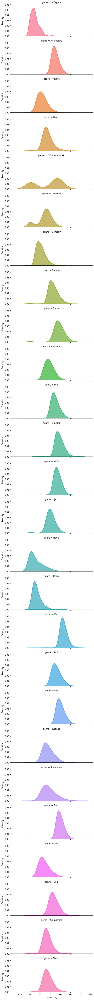

In [74]:
#Não consegui adicionar um título, infelizmente ;(
redgeline = sns.FacetGrid(spotify, row = "genre", hue = "genre", aspect = 2.5, height = 2.5) 
redgeline.map(sns.kdeplot,'popularity', clip_on = True, 
       shade=True, alpha=0.7, lw=2, bw=.4)

Algumas conclusões:
* 'Pop' é o mais popular. Isso já era esperado, pois é um gênero comercial feito, via de regra, para agradar a maior quantidade de pessoas possíveis. 
* Os gêneros tipados como 'popular' também são os primeiros da lista: 'Rock', 'Rap', 'Hip-hop', etc. Isso indica que são mais acessíveis para o entendimento do público. 
* Os menos populares são gênero novos ou destinados a grupos mais específicos, tipicamente relacionados a geekers (como o 'Anime' e 'Comedy'), "pessoas cultas" (como 'A Capella', 'Opera', 'Soundtrack' e 'Classical'), etc.

## **Correlograma, mapa de calor e coordenadas paralelas**

Façamos agora, em última análise, os gráficos padrões para exploração dos dados. Veremos o correlograma, scatter plot e coordenadas paralelas. É claro que a maioria dos atributos ainda não são conhecidas pelo leitor, mas um visão geral antes pode elucidar alguns pontos.

Comecemos pela descrição geral do dataset:

In [75]:
spotify.describe().drop(index = 'count', axis = 0)

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
mean,41.127502,0.368560,0.554364,2.351223e+05,0.570958,0.148301,0.215009,-9.569885,0.120765,117.666585,0.454917
std,18.189948,0.354768,0.185608,1.189359e+05,0.263456,0.302768,0.198273,5.998204,0.185518,30.898907,0.260065
min,0.000000,0.000000,0.056900,1.538700e+04,0.000020,0.000000,0.009670,-52.457000,0.022200,30.379000,0.000000
25%,29.000000,0.037600,0.435000,1.828570e+05,0.385000,0.000000,0.097400,-11.771000,0.036700,92.959000,0.237000
50%,43.000000,0.232000,0.571000,2.204270e+05,0.605000,0.000044,0.128000,-7.762000,0.050100,115.778000,0.444000
75%,55.000000,0.722000,0.692000,2.657680e+05,0.787000,0.035800,0.264000,-5.501000,0.105000,139.054000,0.660000
max,100.000000,0.996000,0.989000,5.552917e+06,0.999000,0.999000,1.000000,3.744000,0.967000,242.903000,1.000000


A princípio, é difícil extrair conclusões desta tabela. No futuro, vamos tratar caso a caso para os atributos.

Agora, dê uma olhada no mapa de calor:

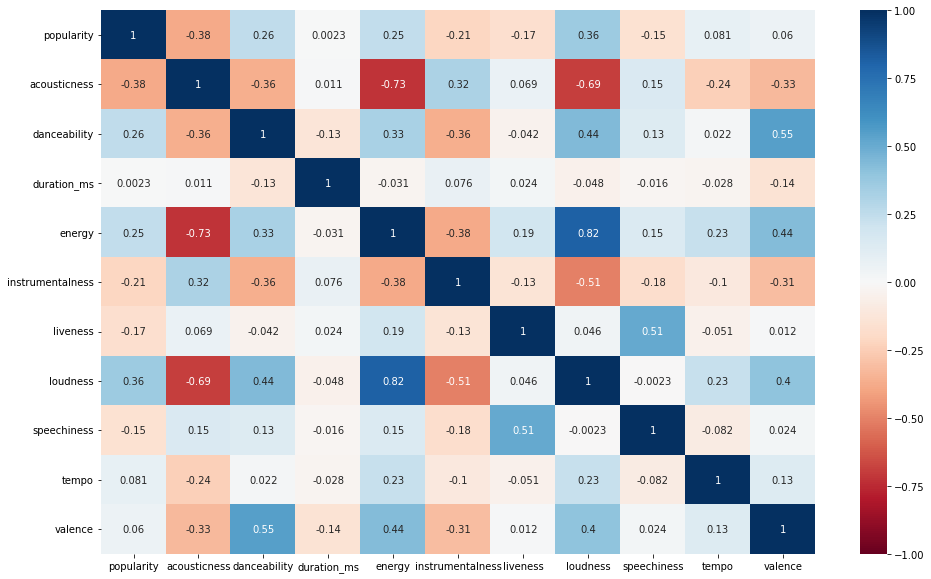

In [76]:
plt.figure(figsize = (16,10))

spotify_corr = spotify.corr()
sns.heatmap(spotify_corr, annot=True, cmap="RdBu", vmin=-1, vmax=1);

Ele fornece muitas informações sobre relações entre os atributos. Infelizmente, não conseguimos ser muito informativos sobre a popularidade. Ver os scatter plots também não ajuda muito. Plotaremos a relação de atributos com maior correlação e, mesmo assim, notará que a visualização não será tão boa.

In [77]:
scatter = px.scatter(spotify,
    x = 'energy', 
    y = 'acousticness',
    marginal_x = "histogram", 
    marginal_y = "violin")
scatter.show()

Fica completamente inviável fazer coordenadas paralelas para quantidade amostras que tem indicando gênero por cor. O máximo que se pode fazer é reduzir a amostragem por gênero. Mesmo assim, nem sempre alguma informação relevante é visível.

In [78]:
def parallel_plot(genero: str):
  parallel = px.parallel_coordinates( spotify[spotify['genre'] == genero],
    dimensions = ['artist_name', 'track_name', 'track_id', 'popularity',
       'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
       'speechiness', 'tempo', 'time_signature', 'valence'],
    color_continuous_scale = px.colors.diverging.Tealrose,
    color_continuous_midpoint = 2,
    title = genero)
  parallel.show()

In [79]:
#Para plotar a coordenada paralela do seu gênero, use a função mudando apenas o nome do gênero:
nome_do_genero = 'A Capella'
parallel_plot(nome_do_genero)

Por fim, vale dizer que o correlograma é completamente inviável para este dataset sem um bom recorte. O máximo que podemos fazer é seguir a ideia que fizemos para Coordenadas Paralelas:

In [80]:
def correlogram_plot(genero: str):
  correlogram = px.scatter_matrix(spotify[spotify['genre'] == genero],
    dimensions = ['popularity',
       'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness',
       'speechiness', 'tempo', 'valence'],
    height=2800, width=2800,
    title= genero)
  correlogram.update_traces(diagonal_visible= True)
  correlogram.show()

In [81]:
#Para plotar a coordenada paralela do seu gênero, use a função mudando apenas o nome do gênero:
nome_do_genero = 'A Capella'
correlogram_plot(nome_do_genero)

Vale ressaltar que só faz sentido, pelo menos para este dataset, fazer Coordenadas Paralelas e Correlograma para atributos numéricos e não para os categóricos. Por fim, também não iremos plotar o correlograma para o dataset inteiro sem definir gêneros pelos mesmos motivos já citados.

## **Observações finais e o track_id**

O atributo `track_id` é um identificador da música no dataset do Spotify. Evidentemente, ele não é útil para nossa análise, visto que temos nosso próprio index. Desta maneira, vamos excluí-lo do dataset principal.

In [82]:
spotify.drop(columns = 'track_id', inplace = True)

Como foi mencionado antes, algumas músicas tem covers. Apenas por cuiriosidade, vamos visualizar as 100 músicas com mais covers. Infelizmente não é possível exibir o artista original, pois o dataset não informa isso. Porém, basta pesquisar o nome da música na barra de pesquisa do google, por exemplo.

In [83]:
size_track = spotify.groupby('track_name').count()
size_track = size_track['genre'].to_frame()
size_track.columns = ['quantidade_de_cover']
size_track.sort_values(by = 'quantidade_de_cover', ascending = False, inplace = True)
size_track.head(100)

,quantidade_de_cover
track_name,
Home,100
You,71
Intro,69
Stay,63
Wake Up,59
...,...
Kids,27
Only You,27
Diamonds,26


Encerrando o tópico geral, combinamos que iríamos falar dos dados ausentes. Resumimos essa parte em: não há! Portanto, não precisamos nos preocupar com tratamento. Veja:

In [84]:
spotify.isnull().any()

genre               False
artist_name         False
track_name          False
popularity          False
acousticness        False
danceability        False
duration_ms         False
energy              False
instrumentalness    False
key                 False
liveness            False
loudness            False
mode                False
speechiness         False
tempo               False
time_signature      False
valence             False
dtype: bool

# **Acousticness**

O atributo `acousticness` é uma métrica que determina o quão confiável é assumir que uma determinada música é acústica ou não. Essa medida varia entre 0 e 1. Quanto mais próximo de 1, mais confiável é fazer essa afirmação.

Mas o que são músicas acústicas? A melhor maneira de explicar é dizendo que são opostas às eletrônicas. Se uma música possui guitarra elétrica, teclado, contra baixo elétrico, dentre outros instrumentos eletrônicos, então ela não é acústica. Ser acústica é preservar as características naturais dos instrumentos. 

Como instrumentos eletrônicos são recentes na história da música, é natural acreditar que a maioria das músicas são acústicas. Mas será que este dataset se comporta assim? Também é legítimo imaginar que alguns gêneros terão destaques do que outros, a começar pelas músicas "Eletronic". Vamos verificar!

OBS: Como repetiremos vários deste procedimentos em outros atributos, resolvemos modulá-los em função. Observe!

## **Visões gerais**

Para todos os atributos, incluindo este, vamos apresentar as visões gerais de maneira parecida como foi feito para `popularity`. O objetivo é transformar a tabela gerada pela função de agregação `describe()` em algo visual. Para isso, faremos o seguinte:
* Plotar tabela `describe()`
* Gerar gráfico de barra da média de acousticness para cada gênero
* Gerar redgeline da distribuição de acousticness para cada gênero
* Box plot do acoustiness para o dataset inteiro

### *Tabela describe:*

In [85]:
def describe_feature(feature: str) -> pd.DataFrame:
  feature_describe = spotify.groupby('genre').describe()[feature].drop(columns = 'count')
  return feature_describe

In [86]:
describe_feature('acousticness')

,mean,std,min,25%,50%,75%,max
genre,,,,,,,
A Capella,0.829941,0.181866,0.154000,0.775500,0.89500,0.96900,0.992
Alternative,0.162313,0.241155,0.000001,0.001950,0.03350,0.23050,0.992
Anime,0.286843,0.362341,0.000000,0.005050,0.06795,0.57725,0.996
Blues,0.327840,0.309981,0.000001,0.041100,0.22900,0.58100,0.996
Children’s Music,0.320112,0.339331,0.000001,0.011200,0.17350,0.61525,0.996
Classical,0.868843,0.255269,0.000001,0.905000,0.96700,0.98800,0.996
Comedy,0.793098,0.130313,0.000363,0.753000,0.81900,0.87200,0.995
Country,0.270172,0.262801,0.000028,0.048000,0.17700,0.43800,0.985
Dance,0.152888,0.184252,0.000004,0.018500,0.07600,0.22500,0.996


Note que é muito difícil visualizar este tipo de dado.

### *Gráfico de barra da média de acousticness para cada gênero*

In [87]:
def bar_mean_feature(feature: str):
  mean_feature = spotify.groupby('genre').mean()
  mean_feature.sort_values(by = feature, ascending = False, inplace = True)
  bar = px.bar( mean_feature,
                x = mean_feature.index, 
                y = feature, 
                title = "Média de " + feature + " por gênero")
  bar.show()

In [88]:
bar_mean_feature('acousticness')

Note que 'Opera', 'Classical', 'A Capella', 'Comedy', 'Soundtrack' e 'Movie' formam o bloco com mais acústica. Isso é natural, pois todos estes gêneros são conhecidos por abusar de instrumentos ou, no caso de 'A Capella' da voz. Em contrapartida, vemos 'Ska', 'Eletronic', 'Dance', 'Alternative' e mais alguns formando o bloco menos acústico. Note que músicas desses gêneros usam muito teclado e guitarra, contribuindo para a posição no gráfico.

### *Redgeline da distribuição de acousticness para cada gênero*

In [89]:
def redgeline_feature(feature: str):
  #Não consegui adicionar um título, infelizmente ;(
  redgeline = sns.FacetGrid(spotify, row = "genre", hue = "genre", aspect = 2.5, height = 2.5) 
  redgeline.map(sns.kdeplot, feature, clip_on = True, 
        shade=True, alpha=0.7, lw=2, bw=.4)

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parame

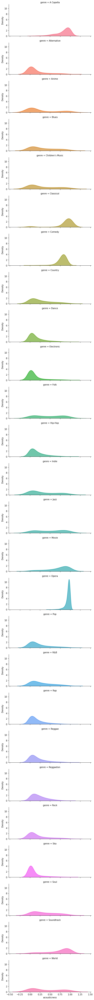

In [90]:
redgeline_feature('acousticness')

Vale a pena observar que alguns dos gráficos do redgeline superam o limite inferior 0 e o superior 1. Isso porque o redgeline não promove uma queda brusca. Após calcular a densidade no ponto 0 e 1, o gráfico começa descer gradativamente.

### *Box plot*

Esta é uma ferramenta gráfica para visualizar distribuição e valores discrepantes (outliers) dos dados. Nela encontra-se localização, dispersão, assimetria, comprimento da cauda e outliers (medidas discrepantes). Para isso, trabalha-se com mínimo, o primeiro quartil (Q1), a mediana, o terceiro quartil (Q3) e o máximo.  

In [91]:
def box_feature(feature:str):
  box = px.box(spotify,
          #points = 'all',
          y = feature, 
          title = "Box plot do data set para o atributo " + feature)
  box.show()

In [92]:
box_feature('acousticness')

## **Análise dos 10%**

Com o intuito de explorar um pouco mais o dataset, repetimos o procedimento feito para o atributo `popularity`:
* Média de acousticness entre os gêneros nos 10% de músicas com mais acousticness
* Quantidade de música por gênero nos 10% de músicas com mais acousticness
* Média de acousticness entre os gêneros nos 10% de músicas com menos acousticness
* Quantidade de música por gênero nos 10% de músicas com menos acousticness

In [93]:
#Fazer a devida documentação das funções
def plot_bar(ter_percent : pd.core.frame.DataFrame, feature : str, title : str):
  bar = px.bar( ter_percent,
                x = ter_percent.index, 
                y = feature, 
                title = title)
  bar.show()

def ter_percent_func (feature: str, bool_ascending : bool):
  #Ordenando o DataFrame segundo a feature
  more_less_feature = spotify.sort_values(by = feature, ascending = bool_ascending)

  #Coletando os 10% menores ou maiores
  ten_percent_head = more_less_feature.head(int(0.1*len(more_less_feature.index)))

  #Agrupando por gênero e tirando a média
  ten_percent_head_feature = ten_percent_head.groupby('genre').mean()
  #Ordenando o recorte
  ten_percent_head_feature.sort_values(by = feature, ascending = False, inplace = True)
  #Setando o título
  if bool_ascending:
    title = "Média de " + feature + " entre os gêneros nos 10% de músicas com menos " + feature
  else:
    title = "Média de " + feature + " entre os gêneros nos 10% de músicas com mais " + feature
  #Executando o plot
  plot_bar(ten_percent_head_feature, feature, title)

  #Agrupando por gênero e fazendo a contagem
  ten_percent_num_head = ten_percent_head.groupby('genre').size()
  #Ordenando o recorte
  ten_percent_num_head.sort_values(ascending = False, inplace = True)
  if bool_ascending:
    title = "Quantidade de música por gênero nos 10% de músicas com menos " + feature
  else:
    title = "Quantidade de música por gênero nos 10% de músicas com mais " + feature
  #Executando o plot
  plot_bar(ten_percent_num_head, ten_percent_num_head, title)

def bar_10_percent_feature (feature : str):
  #Primeiro bloco: 10% com mais feature
  ter_percent_func(feature, False)
  #Segundo bloco: 10% com menos feature
  ter_percent_func(feature, True)

In [94]:
bar_10_percent_feature('acousticness')

Conclusões gerais: todos os gêneros possuem sua parcela de acousticness. 'Opera' e 'Classical' são os mais presentes nos mais acústicos. Entre os menos acústicos, o 'Classical' é o menos acústico. 'Ska', 'Alternative', 'Children Music', 'Eletrocnic' e 'Anime' são mais presentes nos menos acústicos. 

## **Histograma e boxpot para os gêneros destaque**

Apenas a título de curiosidade e para deixar as coisas ainda mais claras, vamos plotar o histogram e o boxplot dos gêneros destaques (tanto para mais, quanto para menos) para o atributo acousticness.

### *Mais destacado*

In [95]:
def box_feature_specifc (feature: str, genero: str):
  box = px.box(spotify[spotify['genre'] == genero],
      #points="all",
      y = feature,
      title = "Box plot do gênero " + genero + " para o atributo " + feature)
  box.show()

In [96]:
box_feature_specifc('acousticness', 'Opera')

In [97]:
def hist_feature_specifc (feature: str, genero: str):
  hist = px.histogram(spotify[spotify['genre'] == genero], 
                  x = feature, 
                  nbins = 200,
                  title = "Distribuição das músicas segundo o atributo " + 
                    feature + " para o gênero " + genero)
  hist.show()

In [98]:
hist_feature_specifc('acousticness', 'Opera')

### *Menos destacado*

In [99]:
box_feature_specifc('acousticness', 'Electronic')

In [100]:
hist_feature_specifc('acousticness', 'Electronic')

## **Conclusões**

Várias conclusões foram feitas e acreditamos que elas são suficientes para análise. A partir de agora, o documento será bem mais sucinto, discursando apenas nas conclusões que acontecerá no final dos tópicos ou sugerindo hipóteses no início.

# **Danceability**

`danceability` indica o quanto uma música é adequada para dançar. Essa métrica é elaborada com base nos elementos músicas (ritmo, força da batida, regularidade geral, etc.). Essa medida varia entre 0 e 1. Quanto mais próximo de 1, mais dançável ela é.

In [200]:
feature = 'danceability'

## **Visões gerais**

### *Tabela describe:*

In [201]:
describe_feature(feature)

,mean,std,min,25%,50%,75%,max
genre,,,,,,,
A Capella,0.412252,0.179719,0.1500,0.2610,0.3530,0.57600,0.784
Alternative,0.541898,0.150391,0.0617,0.4420,0.5390,0.64200,0.971
Anime,0.472090,0.149229,0.0600,0.3800,0.4880,0.57825,0.916
Blues,0.528232,0.145147,0.1140,0.4245,0.5290,0.63350,0.978
Children’s Music,0.598829,0.168058,0.0617,0.4830,0.5970,0.72000,0.989
Classical,0.305958,0.135201,0.0582,0.1980,0.3010,0.40200,0.834
Comedy,0.559038,0.089625,0.2390,0.4990,0.5610,0.62000,0.898
Country,0.577038,0.109771,0.1920,0.5090,0.5800,0.64900,0.964
Dance,0.638191,0.126575,0.1630,0.5580,0.6480,0.72500,0.973


### *Gráfico de barra da média para cada gênero*

In [202]:
bar_mean_feature(feature)

Note que 'Reggaeton', 'Hip-hop', 'Reggae' e 'Rap' são mais dançáveis. 'A Capella', 'Classical', 'Opera' e 'Soundtrack' são menos dançáveis.

### *Redgeline da distribuição para cada gênero*

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parame

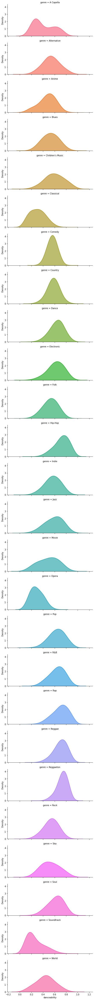

In [203]:
redgeline_feature(feature)

### *Box plot*


In [204]:
box_feature(feature)

## **Análise dos 10%**

In [205]:
bar_10_percent_feature(feature)

## **Histograma e boxpot para os gêneros destaque**

In [206]:
mais_destaque = 'Hip-Hop'
menos_destaque = 'Soundtrack'

### *Mais destacado*

In [207]:
box_feature_specifc(feature, mais_destaque)

In [208]:
hist_feature_specifc(feature, mais_destaque)

### *Menos destacado*

In [209]:
box_feature_specifc(feature, menos_destaque)

In [210]:
hist_feature_specifc(feature, menos_destaque)

# **Energy**

O atributo `energy` mede a intensidade e a atividade da música. Música energéticas são rápidas, altas e barulhentas. Os cálculos desta atributo envolvem timbre, entropia geral, taxa de onset, percepção de volume, etc. Essa medida varia entre 0 e 1. Quanto mais próximo de 1, mais dançável ela é. Quanto mais próximo de 1, mais energética ela é.

Para este atributo, músicas mais "death metal" devem ser mais energéticas que clássicas, por exemplo. "Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale."

In [211]:
feature = 'energy'

## **Visões gerais**

### *Tabela describe:*

In [212]:
describe_feature(feature)

,mean,std,min,25%,50%,75%,max
genre,,,,,,,
A Capella,0.250313,0.198740,0.018000,0.09005,0.1670,0.40050,0.818
Alternative,0.711519,0.206063,0.048400,0.56200,0.7480,0.88800,0.998
Anime,0.665356,0.299668,0.000943,0.42200,0.7830,0.92400,0.999
Blues,0.606171,0.229498,0.009570,0.43750,0.6250,0.79700,0.998
Children’s Music,0.593204,0.253964,0.000499,0.38900,0.6050,0.82100,0.998
Classical,0.177984,0.225483,0.000020,0.03840,0.1030,0.20925,0.995
Comedy,0.676094,0.211705,0.001410,0.52200,0.7040,0.85900,0.998
Country,0.636318,0.200344,0.018800,0.49300,0.6680,0.80000,0.991
Dance,0.698067,0.160860,0.025900,0.58500,0.7120,0.82800,0.999


### *Gráfico de barra da média para cada gênero*

In [213]:
bar_mean_feature(feature)

'Ska', 'Reggaeton' e 'Electronic' são mais energicos. Já 'Opera', 'Classical' e 'Soundtrack' são os menos enérgicos.

### *Redgeline da distribuição para cada gênero*

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parame

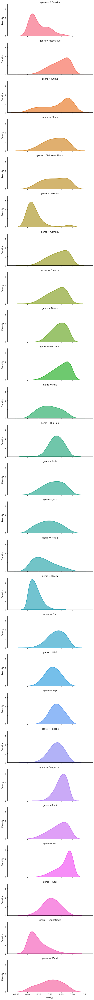

In [214]:
redgeline_feature(feature)

### *Box plot*


In [215]:
box_feature(feature)

## **Análise dos 10%**

In [216]:
bar_10_percent_feature(feature)

CONCLUSÕES

## **Histograma e boxpot para os gêneros destaque**

In [222]:
mais_destaque = 'Ska'
menos_destaque = 'Classical'

### *Mais destacado*

In [223]:
box_feature_specifc(feature, mais_destaque)

In [224]:
hist_feature_specifc(feature, mais_destaque)

### *Menos destacado*

In [225]:
box_feature_specifc(feature, menos_destaque)

In [226]:
hist_feature_specifc(feature, menos_destaque)

# **Instrumentalness**

O `instrumentalness` é uma métrica que determina o quão confiável é assumir que a música não contem vocal. Essa medida varia entre 0 e 1. Quanto mais próximo de 1, mais confiável é fazer essa afirmação.

OBS: "Ooh" e "aah" são tratados como instrumentos neste contexto.

É esperado que gênero como 'Rap' tenho baixíssimo `instrumentalness`.

In [227]:
feature = 'instrumentalness'

## **Visões gerais**

### *Tabela describe:*

In [228]:
describe_feature(feature)

,mean,std,min,25%,50%,75%,max
genre,,,,,,,
A Capella,0.007491,0.040491,0.0,0.000000,0.000000,0.000097,0.336
Alternative,0.061303,0.176176,0.0,0.000000,0.000073,0.006635,0.955
Anime,0.280592,0.391047,0.0,0.000000,0.000414,0.765000,0.997
Blues,0.095175,0.213789,0.0,0.000010,0.001030,0.040650,0.975
Children’s Music,0.087013,0.230714,0.0,0.000000,0.000023,0.005352,0.997
Classical,0.599425,0.377911,0.0,0.145000,0.829000,0.905000,0.994
Comedy,0.000574,0.009987,0.0,0.000000,0.000000,0.000000,0.352
Country,0.005610,0.041811,0.0,0.000000,0.000001,0.000044,0.880
Dance,0.035449,0.143123,0.0,0.000000,0.000001,0.000221,0.979


### *Gráfico de barra da média para cada gênero*

In [229]:
bar_mean_feature(feature)

'Soundtrack' e 'Classical' são isoladamente os gêneros com menor presença de vocal. Em contrapartida, 'Comedy', 'Reggaeton, 'Country' e 'A Capella' são os com mais vocal.

### *Redgeline da distribuição de acousticness para cada gênero*

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parame

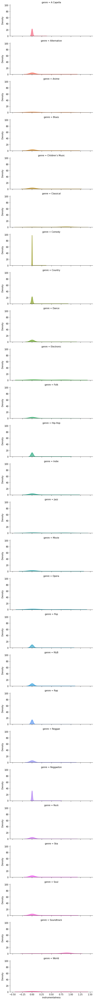

In [230]:
redgeline_feature(feature)

### *Box plot*


In [231]:
box_feature(feature)

## **Análise dos 10%**

In [238]:
bar_10_percent_feature(feature)

## **Histograma e boxpot para os gêneros destaque**

In [239]:
mais_destaque = 'Soundtrack'
menos_destaque = 'Comedy'

### *Mais destacado*

In [240]:
box_feature_specifc(feature, mais_destaque)

In [241]:
hist_feature_specifc(feature, mais_destaque)

### *Menos destacado*

In [242]:
box_feature_specifc(feature, menos_destaque)

In [243]:
hist_feature_specifc(feature, menos_destaque)

# **Liveness**

`liveness` é uma métrica que determina o quão confiável é assumir a música possui plateia. Essa medida varia entre 0 e 1. Quanto mais próximo de 1, mais confiável é fazer essa afirmação.

In [244]:
feature = 'liveness'

## **Visões gerais**

### *Tabela describe:*

In [245]:
describe_feature(feature)

,mean,std,min,25%,50%,75%,max
genre,,,,,,,
A Capella,0.136924,0.063144,0.03690,0.097600,0.114,0.1605,0.381
Alternative,0.196985,0.157880,0.02110,0.098300,0.131,0.2550,0.996
Anime,0.192391,0.139406,0.01370,0.098200,0.137,0.2740,0.981
Blues,0.233125,0.219053,0.00967,0.098100,0.139,0.2870,1.000
Children’s Music,0.183986,0.148114,0.01190,0.094300,0.125,0.2280,0.981
Classical,0.162810,0.145103,0.02250,0.089500,0.110,0.1610,0.987
Comedy,0.724775,0.223437,0.02580,0.662000,0.767,0.8980,0.996
Country,0.187216,0.153139,0.01430,0.098775,0.128,0.2300,0.994
Dance,0.187753,0.148386,0.01490,0.092000,0.129,0.2460,0.988


### *Gráfico de barra da média para cada gênero*

In [246]:
bar_mean_feature(feature)

'Comedy' é o vencedor isolado deste atributo. Todos os outros são quase que equivalentes, mas 'A Capella' é o menor.

### *Redgeline da distribuição para cada gênero*

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parame

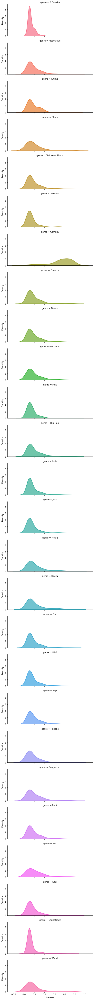

In [247]:
redgeline_feature(feature)

### *Box plot*


In [248]:
box_feature(feature)

## **Análise dos 10%**

In [249]:
bar_10_percent_feature(feature)

## **Histograma e boxpot para os gêneros destaque**

In [255]:
mais_destaque = 'Comedy'
menos_destaque = 'Children’s Music'

### *Mais destacado*

In [256]:
box_feature_specifc(feature, mais_destaque)

In [257]:
hist_feature_specifc(feature, mais_destaque)

### *Menos destacado*

In [258]:
box_feature_specifc(feature, menos_destaque)

In [259]:
hist_feature_specifc(feature, menos_destaque)

#**Loudness**

O atributo `loudness` é o volume, medido em decibéis, médio de uma faixa. Os valores geralmente variam entre -60 e 0 db.

Útil para comparar os volumes. Adiantamos que muito das faixas de baixos decibéis na possem erro de áudio ou de gravação de forma que simplesmente não saem som. s oueh erro de gravacao. as primeria q começam q surgir a medid que avança no decibel sao classicas e soundtrack

In [260]:
feature = 'loudness'

## **Visões gerais**

### *Tabela describe:*

In [146]:
describe_feature(feature)

,mean,std,min,25%,50%,75%,max
genre,,,,,,,
A Capella,-13.660387,5.437118,-29.368,-18.27300,-14.4640,-8.61050,-3.555
Alternative,-6.540803,2.764235,-27.119,-8.02650,-6.0280,-4.52200,1.342
Anime,-7.917802,6.184689,-41.234,-10.69125,-5.6015,-3.58375,1.893
Blues,-9.053807,3.855575,-31.284,-11.39800,-8.4830,-6.20350,3.744
Children’s Music,-8.399591,4.201918,-36.721,-10.82700,-7.4870,-5.20275,1.342
Classical,-21.544477,7.682214,-47.599,-26.45925,-21.7970,-17.23300,-1.786
Comedy,-11.689321,4.777983,-31.047,-14.64900,-11.2090,-8.08800,-0.255
Country,-7.341693,3.250495,-27.119,-8.94300,-6.5090,-5.01900,-0.521
Dance,-6.054241,2.334848,-30.016,-7.19100,-5.6890,-4.48700,1.342


### *Gráfico de barra da média para cada gênero*

In [261]:
bar_mean_feature(feature)

A média de volume relativo é bem menor em 'A Capella', 'Soundtrack', 'Opera' e 'Classical'. 'Reggaeton', 'Dance', 'Ska' e 'Pop' são maiores.

### *Redgeline da distribuição para cada gênero*

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parame

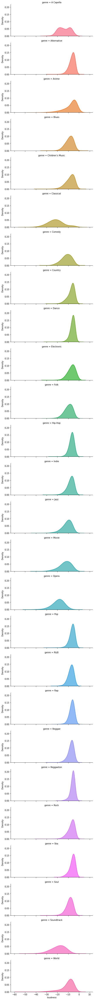

In [148]:
redgeline_feature(feature)

### *Box plot*


In [149]:
box_feature(feature)

## **Análise dos 10%**

In [150]:
bar_10_percent_feature(feature)

## **Histograma e boxpot para os gêneros destaque**

In [262]:
mais_destaque = 'Anime'
menos_destaque = 'Classical'

### *Mais destacado*

In [263]:
box_feature_specifc(feature, mais_destaque)

In [264]:
hist_feature_specifc(feature, mais_destaque)

### *Menos destacado*

In [265]:
box_feature_specifc(feature, menos_destaque)

In [266]:
hist_feature_specifc(feature, menos_destaque)

# **Speechiness**

O atributo `speechiness` indica a presença de palavras faladas. Valores acima de 0.66 descrevem músicas que provavelmente são feitas inteiramente de palavras faladas. Valores entre 0.33 e 0.66 descrevem músicas que podem conter música e fala. Valores abaixo de 0.33 representam músicas que não possuem palavras faladas.

In [267]:
feature = 'speechiness'

## **Visões gerais**

### *Tabela describe:*

In [157]:
describe_feature(feature)

,mean,std,min,25%,50%,75%,max
genre,,,,,,,
A Capella,0.042414,0.018254,0.0254,0.03175,0.03450,0.043350,0.0983
Alternative,0.088783,0.091241,0.0229,0.03580,0.05200,0.096900,0.9410
Anime,0.065102,0.053889,0.0227,0.03470,0.04515,0.071525,0.5270
Blues,0.061809,0.061537,0.0231,0.03380,0.04310,0.064500,0.9430
Children’s Music,0.097763,0.123095,0.0229,0.03630,0.05230,0.097400,0.9610
Classical,0.052001,0.040798,0.0238,0.03840,0.04330,0.050500,0.8890
Comedy,0.853532,0.205918,0.0230,0.88800,0.92800,0.944000,0.9670
Country,0.048989,0.048392,0.0223,0.02960,0.03480,0.045900,0.6890
Dance,0.083608,0.077924,0.0228,0.03740,0.05270,0.092200,0.8690


### *Gráfico de barra da média para cada gênero*

In [158]:
bar_mean_feature(feature)

### *Redgeline da distribuição para cada gênero*

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parame

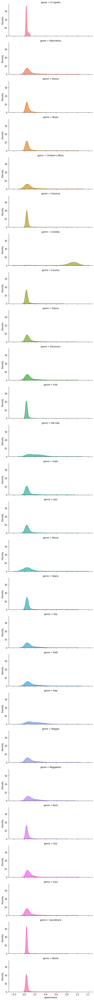

In [159]:
redgeline_feature(feature)

### *Box plot*


In [160]:
box_feature(feature)

## **Análise dos 10%**

In [161]:
bar_10_percent_feature(feature)

## **Histograma e boxpot para os gêneros destaque**

In [268]:
mais_destaque = 'Comedy'
menos_destaque = 'Country'

### *Mais destacado*

In [269]:
box_feature_specifc(feature, mais_destaque)

In [270]:
hist_feature_specifc(feature, mais_destaque)

### *Menos destacado*

In [271]:
box_feature_specifc(feature, menos_destaque)

In [272]:
hist_feature_specifc(feature, menos_destaque)

# **Tempo**

O atributo `tempo` o ritmo médio da música. A medida é atráveis de batidas por minuto (BPM).

In [279]:
feature = 'tempo'

## **Visões gerais**

### *Tabela describe:*

In [168]:
describe_feature(feature)

,mean,std,min,25%,50%,75%,max
genre,,,,,,,
A Capella,111.518950,29.523057,37.861,89.57900,110.1210,129.68300,181.714
Alternative,122.534485,30.129437,44.194,97.33150,120.0230,143.96550,213.788
Anime,126.629156,33.160207,32.080,98.92125,127.7995,149.99125,220.276
Blues,121.137637,30.387693,35.204,97.56650,117.7940,140.63550,242.903
Children’s Music,121.638247,30.144981,33.792,98.03100,119.9585,140.09250,220.119
Classical,104.341807,31.038727,34.208,79.32000,97.0965,127.18125,212.923
Comedy,98.235488,27.839986,32.451,79.72000,90.1240,115.12800,207.157
Country,123.414419,30.237831,48.718,98.04575,122.9045,144.48075,217.538
Dance,120.795919,26.092474,44.573,100.97200,120.0390,134.03000,218.081


### *Gráfico de barra da média para cada gênero*

In [169]:
bar_mean_feature(feature)

Neste atributo, as músicas distoam muito pouco. Mesmo sendo vencedor, 'Ska' não é muito diferente do perdedor 'Comedy'

### *Redgeline da distribuição para cada gênero*

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parame

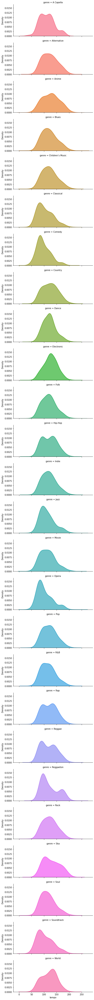

In [170]:
redgeline_feature(feature)

### *Box plot*


In [171]:
box_feature(feature)

## **Análise dos 10%**

In [172]:
bar_10_percent_feature(feature)

CONCLUSÕES

## **Histograma e boxpot para os gêneros destaque**

In [280]:
mais_destaque = 'Ska'
menos_destaque = 'Comedy'

### *Mais destacado*

In [281]:
box_feature_specifc(feature, mais_destaque)

In [282]:
hist_feature_specifc(feature, mais_destaque)

### *Menos destacado*

In [283]:
box_feature_specifc(feature, menos_destaque)

In [284]:
hist_feature_specifc(feature, menos_destaque)

# **Valence**

O atributo `valence` descreve a "positividade transmitida" por uma música. Essa medida varia entre 0 e 1. Quanto mais próximo de 1, mais o som soa positivo (ou seja, feliz, alegre, eufórico, etc.). Quanto mais próximo de 0, mais o som soa negativo (ou seja, triste, deprimido, irritado, etc.)

In [285]:
feature = 'valence'

## **Visões gerais**

### *Tabela describe:*

In [179]:
describe_feature(feature)

,mean,std,min,25%,50%,75%,max
genre,,,,,,,
A Capella,0.328724,0.255005,0.0380,0.12650,0.2260,0.54350,0.966
Alternative,0.449590,0.216426,0.0321,0.28400,0.4320,0.60100,0.983
Anime,0.441682,0.249619,0.0000,0.23400,0.4400,0.63325,1.000
Blues,0.579425,0.224677,0.0315,0.40800,0.5900,0.75900,0.985
Children’s Music,0.532251,0.250929,0.0000,0.33400,0.5250,0.73400,1.000
Classical,0.214463,0.200275,0.0000,0.05720,0.1430,0.31325,0.982
Comedy,0.412764,0.207258,0.0237,0.25200,0.4100,0.56100,0.980
Country,0.535160,0.219819,0.0395,0.35800,0.5300,0.71000,0.985
Dance,0.517754,0.226822,0.0340,0.34100,0.5110,0.69500,0.986


### *Gráfico de barra da média para cada gênero*

In [180]:
bar_mean_feature(feature)

'Reggae', 'Reggaeton' e 'Ska' são bem mais animados do que 'Classical', 'Opera' e 'Soundtrack'.

### *Redgeline da distribuição para cada gênero*

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parameters and update your code.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:1699: FutureWarning:

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`. Using 0.4 for `bw_method`, but please see the docs for the new parame

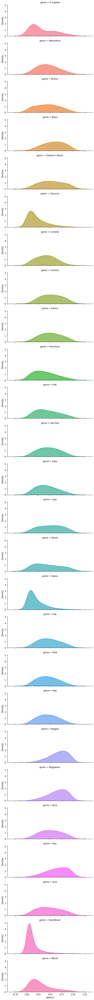

In [181]:
redgeline_feature(feature)

### *Box plot*


In [182]:
box_feature(feature)

## **Análise dos 10%**

In [183]:
bar_10_percent_feature(feature)

CONCLUSÕES

## **Histograma e boxpot para os gêneros destaque**

In [286]:
mais_destaque = 'Reggae'
menos_destaque = 'Soundtrack'

### *Mais destacado*

In [287]:
box_feature_specifc(feature, mais_destaque)

In [288]:
hist_feature_specifc(feature, mais_destaque)

### *Menos destacado*

In [289]:
box_feature_specifc(feature, menos_destaque)

In [290]:
hist_feature_specifc(feature, menos_destaque)

# **Duration_ms**

O atributo `duration_ms` é o tempo, em milisegundos, da música.

Sobre este atributo, não há muito que discutir, pois a faixa de tempo da maioria das músicas são muito parecidas. Desta maneira, optamos apenas por transformar a unidade de medida da música de milissegundos para minutos:

In [293]:
spotify['duration_ms'] = spotify.apply(lambda x: x.duration_ms/60000, axis = 1)

# **Key, mode e time_signature**

* `key`: o tom a qual a música pertence/está. No total, são 12. Caso não tenha sido detectado, vale -1;
* `mode`: indica escala melódica da música. Pode assumir 'Minor' ou 'Major';
* `time_signature`: é uma notação para especificar o quantas batidas cada compasso tem.

Como são dados categóricos e muito específico para quem entende de música, fica um pouco díficil analisar. Portanto, vamos plotar o valor modal de cada gênero.

In [297]:
spotify.groupby(['genre']).agg(pd.Series.mode)[['key','mode','time_signature']]

,key,mode,time_signature
genre,,,
A Capella,"[C, G]",Major,4/4
Alternative,C,Major,4/4
Anime,C,Major,4/4
Blues,G,Major,4/4
Children’s Music,C,Major,4/4
Classical,G,Major,4/4
Comedy,C#,Major,4/4
Country,G,Major,4/4
Dance,C,Major,4/4


OBS: se der tempo, vamos visualizar a quantidade de cada um.

# **Outros**

Por fim, apenas por curiosidade, segue uma comparaçao entre duas músicas com mesmo track_name, mas artist_name diferentes. Gostaríamos de ter gerado um spider plot, mas infelizmente não conseguimos.

In [49]:
spotify_droped = spotify.drop(columns = ['genre','artist_name','track_name','key','mode','time_signature','duration_ms'])
scaler = preprocessing.MinMaxScaler()
scaled = scaler.fit_transform(spotify_droped)
spotify_scaled = pd.DataFrame(data = scaled, columns = spotify_droped.columns)
compare_music = spotify_scaled[(spotify_scaled.index == 153996) | (spotify_scaled.index == 65586)]

,popularity,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
65586,0.38,0.220884,0.704967,0.728723,0.0,0.242677,0.853935,0.013230,0.417125,0.821
153996,0.52,0.011345,0.683510,0.872870,0.0,0.023255,0.859949,0.155377,0.445136,0.626


Uma outra ideia interessante que, infelizmente, não tivemos tempo hábil, é a de gerar uma núvem de palavras relacionando músicas a seu nível de popularidade. As cores representariam o gênero a qual pertence. Provavelmente, no entando, não daria certo pelo alto números de músicas.